In [1]:
import scanpy as sc
import numpy as np
import pandas as pd
import seaborn as sns

sc.set_figure_params(figsize=(8, 8))

In [2]:
from pathlib import Path

path = 'D:/st_projects/data/Intestine/A1'
path = Path(path)
files = dict(
    tissue_positions_file=path / 'spatial/tissue_positions_list.csv',
    scalefactors_json_file=path / 'spatial/scalefactors_json.json',
    hires_image=path / 'spatial/tissue_hires_image.png',
    lowres_image=path / 'spatial/tissue_lowres_image.png',
)

In [3]:
import json
from matplotlib.image import imread
from h5py import File

adata = sc.read_h5ad('D:/st_projects/data/Intestine/A1/10X_Visium_fawkner2021spatiotemporal_A1_data.h5ad')
library_id = 'A1'
adata.uns["spatial"] = dict()
adata.uns["spatial"][library_id] = dict()

# check if files exists, continue if images are missing
adata.uns["spatial"][library_id]['images'] = dict()

for res in ['hires', 'lowres']:
    adata.uns["spatial"][library_id]['images'][res] = imread(str(files[f'{res}_image']))
    
adata.uns["spatial"][library_id]['scalefactors'] = json.loads(files['scalefactors_json_file'].read_bytes())

positions = pd.read_csv(files['tissue_positions_file'], header=None)
positions.columns = [
    'barcode',
    'in_tissue',
    'array_row',
    'array_col',
    'pxl_col_in_fullres',
    'pxl_row_in_fullres',
]
positions.index = positions['barcode']
adata.obs = adata.obs.join(positions, how="left")

adata.obsm['spatial'] = adata.obs[['pxl_row_in_fullres', 'pxl_col_in_fullres']].to_numpy()
adata.obs.drop(columns=['barcode', 'pxl_row_in_fullres', 'pxl_col_in_fullres'], inplace=True,)

In [4]:
adata.obsm['spatial'], adata

(array([[5303, 4372],
        [4960, 1753],
        [5097, 5173],
        ...,
        [4253, 2992],
        [2795, 4962],
        [2165, 4018]], dtype=int64),
 AnnData object with n_obs × n_vars = 2649 × 33538
     obs: 'clusters', 'leiden', 'in_tissue', 'array_row', 'array_col'
     var: 'gene_ids', 'feature_types', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
     uns: 'clusters_colors', 'hvg', 'leiden', 'leiden_colors', 'log1p', 'moranI', 'neighbors', 'pca', 'spatial_neighbors', 'umap', 'spatial'
     obsm: 'X_pca', 'X_umap', 'spatial', 'spatial_pixel', 'spatial_real'
     varm: 'PCs'
     obsp: 'connectivities', 'distances', 'spatial_connectivities', 'spatial_distances')

C:\ProgramData\anaconda3\envs\gpudeepl\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\ProgramData\anaconda3\envs\gpudeepl\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


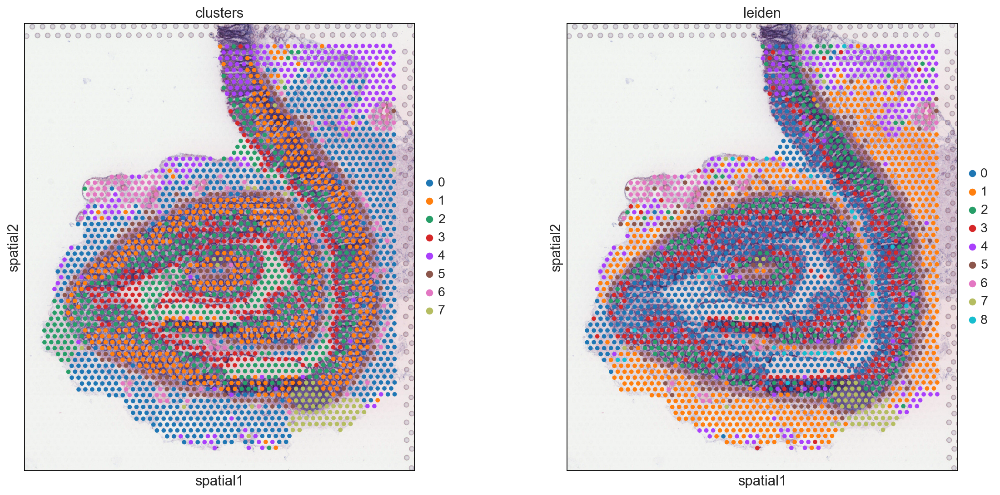

In [5]:
sc.pl.spatial(adata, color=['clusters', 'leiden'])

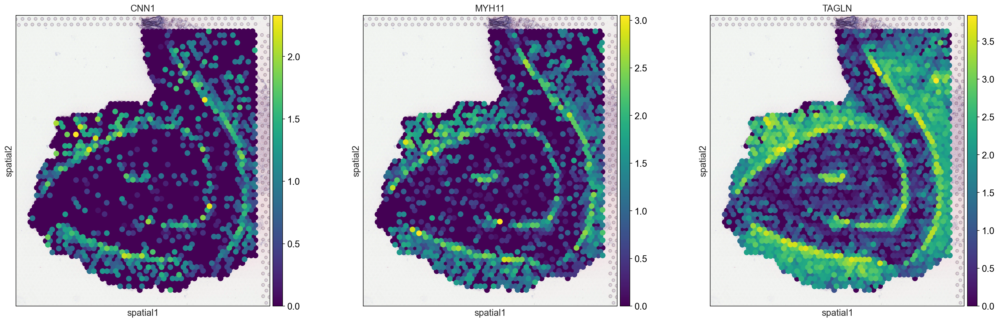

In [6]:
sc.pl.spatial(adata, color=['CNN1', 'MYH11', 'TAGLN'], size=2, color_map='viridis')

In [7]:
from image_feature import image_crop, ImageFeature
import os
section = 'Intestine_A1'

# extract deep image features
# 提取形态学特征
save_path = 'results'
save_path_image_crop = Path(os.path.join(save_path, 'image_crop', f'{section}'))
save_path_image_crop.mkdir(parents=True, exist_ok=True)

adata = image_crop(adata, save_path=save_path_image_crop, crop_size=56, verbose=False)
adata = ImageFeature(adata, pca_components=200, verbose=True, seeds=2023).extract_image_features()

Tiling Image: 100%|██████████ [ time left: 00:00 ]
Extract image feature: 100%|██████████ [ time left: 00:00 ]  


The image feature is added to adata.obsm['Image_Feature']
The pca result of image features is added to adata.obsm['image_feat_pca']


Finding 30 nearest neighbors using minkowski metric and 'auto' algorithm
Neighbors computed in 0.6648578643798828 seconds
Jaccard graph constructed in 2.5997323989868164 seconds
Wrote graph to binary file in 0.017999887466430664 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.771254
Louvain completed 21 runs in 1.5965869426727295 seconds
Sorting communities by size, please wait ...
PhenoGraph completed in 5.7698962688446045 seconds


C:\ProgramData\anaconda3\envs\gpudeepl\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


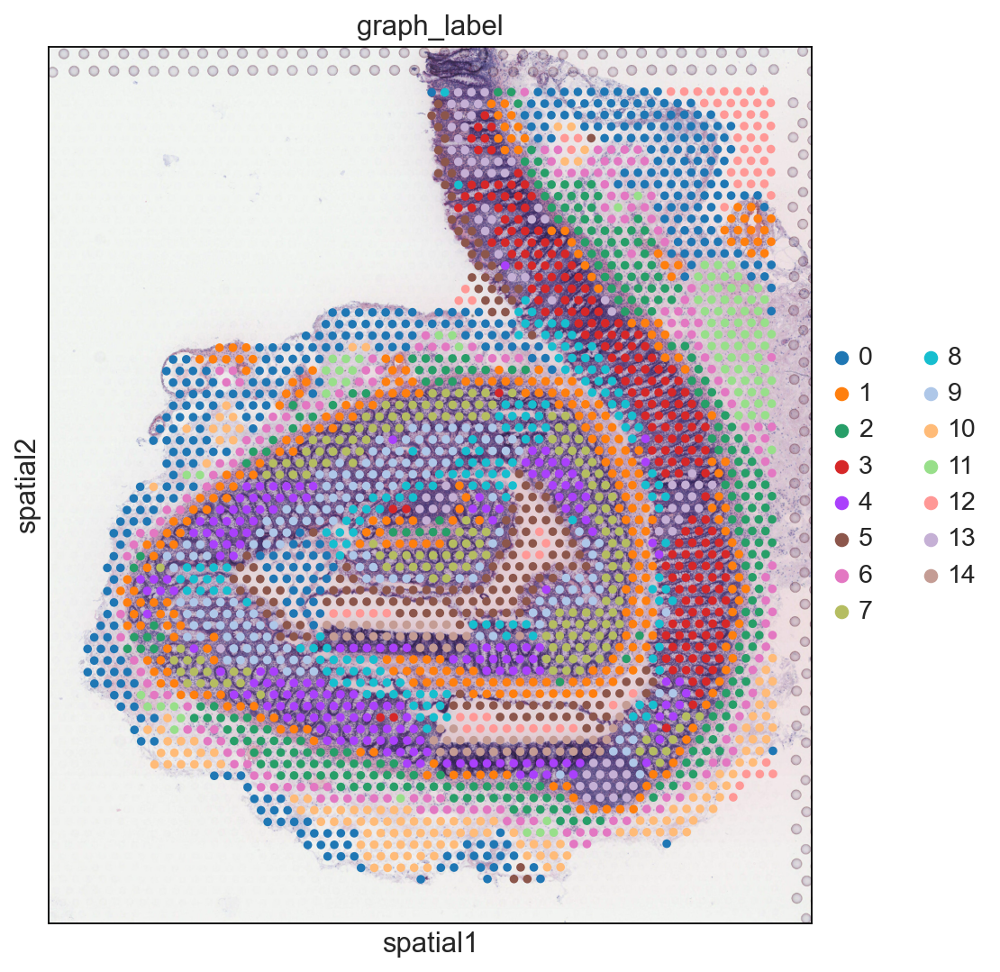

In [8]:
import phenograph
graph_label, _, _ = phenograph.cluster(adata.obsm['image_feat_pca'])
adata.obs['graph_label'] = graph_label
adata.obs['graph_label'] = adata.obs['graph_label'].astype('category')
sc.pl.spatial(adata, color='graph_label', size=1)

In [9]:
sc.pp.calculate_qc_metrics(adata, inplace=True)
sc.pp.filter_genes(adata, min_counts=10)

sc.pp.highly_variable_genes(adata, flavor="seurat_v3", n_top_genes=3000)
sc.pp.scale(adata, zero_center=False, max_value=10)
adata

C:\ProgramData\anaconda3\envs\gpudeepl\lib\site-packages\scanpy\preprocessing\_highly_variable_genes.py:61: UserWarning: `flavor='seurat_v3'` expects raw count data, but non-integers were found.
  warnings.warn(


AnnData object with n_obs × n_vars = 2649 × 13000
    obs: 'clusters', 'leiden', 'in_tissue', 'array_row', 'array_col', 'image_col', 'image_row', 'slice_path', 'graph_label', 'n_genes_by_counts', 'log1p_n_genes_by_counts', 'total_counts', 'log1p_total_counts', 'pct_counts_in_top_50_genes', 'pct_counts_in_top_100_genes', 'pct_counts_in_top_200_genes', 'pct_counts_in_top_500_genes'
    var: 'gene_ids', 'feature_types', 'highly_variable', 'means', 'dispersions', 'dispersions_norm', 'n_cells_by_counts', 'mean_counts', 'log1p_mean_counts', 'pct_dropout_by_counts', 'total_counts', 'log1p_total_counts', 'n_counts', 'highly_variable_rank', 'variances', 'variances_norm', 'mean', 'std'
    uns: 'clusters_colors', 'hvg', 'leiden', 'leiden_colors', 'log1p', 'moranI', 'neighbors', 'pca', 'spatial_neighbors', 'umap', 'spatial', 'graph_label_colors'
    obsm: 'X_pca', 'X_umap', 'spatial', 'spatial_pixel', 'spatial_real', 'image_feature', 'aug_image_feature1', 'aug_image_feature2', 'image_feat_pca'
  

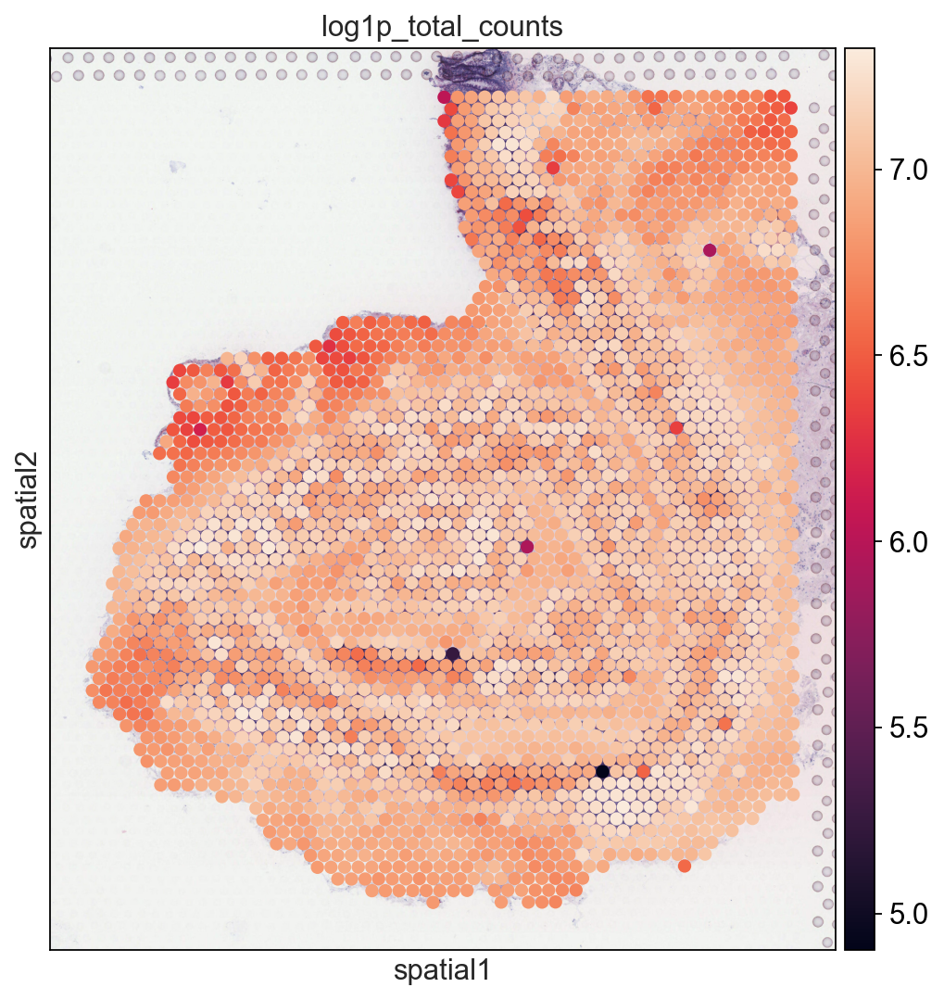

In [10]:
sc.pl.spatial(adata, color='log1p_total_counts', size=1.5)

In [11]:
from utils import construction_interaction
from sklearn.metrics import pairwise_distances

construction_interaction(adata, n_neighbor=6)
adj = adata.obsm['adj']

morphological_similarity = 1 - pairwise_distances(np.array(adata.obsm['image_feat_pca']), metric='cosine')
morphological_similarity[morphological_similarity < 0] = 0

adj_spatial_mor = adj * morphological_similarity

C:\ProgramData\anaconda3\envs\gpudeepl\lib\site-packages\ot\backend.py:2998: UserWarning: To use TensorflowBackend, you need to activate the tensorflow numpy API. You can activate it by running: 
from tensorflow.python.ops.numpy_ops import np_config
np_config.enable_numpy_behavior()
  register_backend(TensorflowBackend())


In [12]:
# 数据增广
from scipy.sparse import csr_matrix

if isinstance(adata.X, csr_matrix):
    gene_matrix = adata.X.A
elif isinstance(adata.X, np.ndarray):
    gene_matrix = adata.X
elif isinstance(adata.X, pd.DataFrame):
    gene_matrix = adata.X.values
else:
    raise ValueError(f"{type(adata.X)} is not a valid type here")

# 各个Spot对当前Spot归一化后的权重
weights_list = []
final_coordinates = []

for i in range(adata.shape[0]):
    current_spot = adj_spatial_mor[i].argsort()[-6: ][: -1]
    spot_weight = adj_spatial_mor[i][current_spot]
    spot_feature_matrix = gene_matrix[current_spot]
    
    spot_weight_scaled = spot_weight / spot_weight.sum()
    weights_list.append(spot_weight_scaled)
    spot_matrix_scaled = np.multiply(spot_weight_scaled.reshape(-1, 1), spot_feature_matrix)
    spot_matrix_final = np.sum(spot_matrix_scaled, axis=0)
    final_coordinates.append(spot_matrix_final)

In [13]:
adjacent_spot_data = np.array(final_coordinates)
adjacent_weight = 0.3

if isinstance(adata.X, np.ndarray):
    augment_gene_matrix = adata.X + adjacent_weight * adjacent_spot_data.astype(float)
elif isinstance(adata.X, csr_matrix):
    augment_gene_matrix = adata.X.A + adjacent_weight * adjacent_spot_data.astype(float)
    
augment_gene_matrix.shape

(2649, 13000)

In [14]:
from sklearn.decomposition import PCA

pca = PCA(n_components=50, random_state=42)
aug_pca = pca.fit_transform(augment_gene_matrix)

Finding 30 nearest neighbors using minkowski metric and 'auto' algorithm
Neighbors computed in 0.10938405990600586 seconds
Jaccard graph constructed in 2.6174511909484863 seconds
Wrote graph to binary file in 0.029517412185668945 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.807044
After 2 runs, maximum modularity is Q = 0.810133
Louvain completed 22 runs in 1.833794355392456 seconds
Sorting communities by size, please wait ...
PhenoGraph completed in 5.452974319458008 seconds


C:\ProgramData\anaconda3\envs\gpudeepl\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


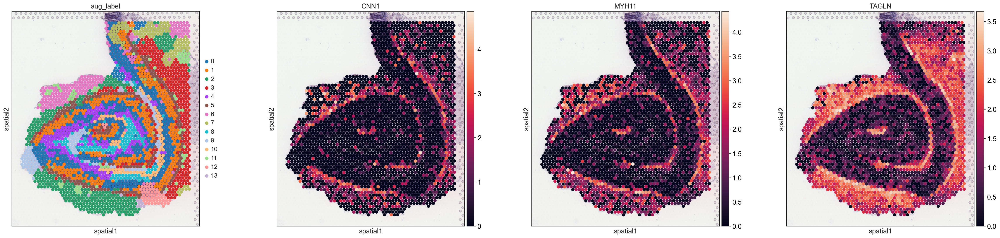

In [15]:
import phenograph
aug_label, _, _ = phenograph.cluster(aug_pca)
adata.obs['aug_label'] = aug_label
adata.obs['aug_label'] = adata.obs['aug_label'].astype('category')
sc.pl.spatial(adata, color=['aug_label', 'CNN1', 'MYH11', 'TAGLN'], size=1.5)

In [18]:
import torch
from utils import add_contrastive_label, get_feature

device = torch.device('cuda') if torch.cuda.is_available() else 'cpu'
adata.obsm['augment_gene_data'] = augment_gene_matrix
add_contrastive_label(adata)
get_feature(adata)

features = torch.FloatTensor(adata.obsm['feat'].copy()).to(device)
features_fake = torch.FloatTensor(adata.obsm['feat_fake'].copy()).to(device)
label_CSL = torch.FloatTensor(adata.obsm['label_CSL']).to(device)

In [19]:
from utils import preprocess_adj
import torch.nn as nn
from tqdm import tqdm
import torch.nn.functional as F

from torchtoolbox.tools import mixup_criterion
from loss import Objective
from model import OurModel

dim_input = features.shape[1]
dim_output = 32

adj = preprocess_adj(adj_spatial_mor)
adj = torch.FloatTensor(adj).to(device)

image_feature = torch.FloatTensor(adata.obsm['image_feature']).to(device)
aug_image_feature1 = torch.FloatTensor(adata.obsm['aug_image_feature1']).to(device)
aug_image_feature2 = torch.FloatTensor(adata.obsm['aug_image_feature2']).to(device)


model = OurModel(gene_dims=[adata.shape[1], 64], img_dims=[adata.obsm['image_feature'].shape[1], 64], graph_nei=adj, project_dims=[64, 32]).to(device)

loss_CSL = nn.BCEWithLogitsLoss()
loss_cont = Objective(batch_size=adata.shape[0])

optimizer = torch.optim.Adam(model.parameters(), lr=1e-4, weight_decay=0.)
print('Begin to train ST data...')

alpha = 1
beta = 0.1
gamma = 1
sigma = 1
model.train()

epoch_iter = tqdm(range(1700))
for epoch in epoch_iter:
    # zg, zi, aug_zi, hg, hi, aug_hi, dis_a, dis_b, rec_gene
    latent_gene, latent_img, latent_aug_img1, latent_aug_img2, high_gene, high_img, high_aug_img1, high_aug_img2, ret, ret_fake, rec_data, rec_img = model.forward(features, features_fake, image_feature, aug_image_feature1, aug_image_feature2, adj)
    loss_sl_1 = loss_CSL(ret, label_CSL)
    loss_sl_2 = loss_CSL(ret_fake, label_CSL)
    loss_g2g = loss_sl_1 + loss_sl_2

    loss_feat = F.mse_loss(features, rec_data)
    loss_img = F.mse_loss(image_feature, rec_img)
    
    loss_recon = alpha * loss_feat + (1 - alpha) * loss_img
    if epoch < 1500:
        loss = loss_recon + beta * loss_g2g
    else:
        loss_i2i = loss_cont(high_aug_img1, high_aug_img2)
        lam = np.random.beta(0.2, 0.2)
        loss_i2g = mixup_criterion(loss_cont, high_gene, high_img, high_aug_img1, lam)
        loss = loss_recon + beta * (loss_sl_1 + loss_sl_2) + gamma * loss_i2i + sigma * loss_i2g
        
    if epoch == 1500:
        print(f"# Epoch {epoch}, loss: {loss.item():.3f}, g2g_loss: {loss_g2g.item():.3f}, gene_recon: {loss_feat.item():.3f}, image_recon: {loss_img.item():.3f}")
        print('Init finished, start contrastive learning part')
    optimizer.zero_grad()
    loss.backward()
    optimizer.step()
    
    if epoch < 1500:
        epoch_iter.set_description(
        f"# Epoch {epoch}, loss: {loss.item():.3f}, g2g_loss: {loss_g2g.item():.3f}, gene_recon: {loss_feat.item():.3f}, image_recon: {loss_img.item():.3f}")
    else:
        epoch_iter.set_description(
        f"# Epoch {epoch}, loss: {loss.item():.3f}, g2i_loss: {loss_i2g.item():.3f}, g2g_loss: {loss_g2g.item():.3f}, i2i_loss: {loss_i2i.item():.3f}, gene_recon: {loss_feat.item():.3f}, image_recon: {loss_img.item():.3f}") 
print('Optimization finished for ST data!')

Begin to train ST data...


# Epoch 1499, loss: 0.865, g2g_loss: 0.183, gene_recon: 0.847, image_recon: 0.120:  88%|████████▊ | 1499/1700 [00:29<00:04, 49.47it/s]

# Epoch 1500, loss: 90.739, g2g_loss: 0.182, gene_recon: 0.847, image_recon: 0.120
Init finished, start contrastive learning part


# Epoch 1699, loss: 18.211, g2i_loss: 8.670, g2g_loss: 1.141, i2i_loss: 8.565, gene_recon: 0.861, image_recon: 0.128: 100%|██████████| 1700/1700 [03:26<00:00,  8.25it/s] 

Optimization finished for ST data!


In [20]:
with torch.no_grad():
    model.eval()
    latent_gene, latent_img, latent_aug_img1, latent_aug_img2, high_gene, high_img, high_aug_img1, high_aug_img2, ret, ret_fake, rec_data, rec_img = model.forward(features, features_fake, image_feature, aug_image_feature1, aug_image_feature1, adj)
    latent_gene = latent_gene.detach().cpu().numpy()
    latent_img = latent_img.detach().cpu().numpy()
    rec_data = rec_data.detach().cpu().numpy()
    rec_img = rec_img.detach().cpu().numpy()

In [24]:
adata.obsm['rec_feature'] = rec_data
adata.layers['My_ReX'] = rec_data

pca = PCA(n_components=32, random_state=2023)
rec_feat_pca = pca.fit_transform(rec_data)
rec_img_pca = pca.fit_transform(rec_img)
adata.obsm['rec_feat_pca'] = rec_feat_pca
adata.obsm['rec_img_pca'] = rec_img_pca
adata.obsm['fusion_pca'] = rec_feat_pca + alpha * rec_img_pca

rec_data.shape, rec_feat_pca.shape, rec_img_pca.shape

((2649, 13000), (2649, 20), (2649, 20))

In [25]:
from utils import mclust_R, refine_label, clustering
import os
os.environ['R_HOME'] = 'C:/Program Files/R/R-4.3.1'

tool = 'mclust'
radius = 5

mclust_R(adata, used_obsm='fusion_pca', num_cluster=15)
adata.obs['domain'] = adata.obs['mclust']
new_type = refine_label(adata, radius, key='domain')
adata.obs['domain'] = new_type

fitting ...
  |======================================================================| 100%


C:\ProgramData\anaconda3\envs\gpudeepl\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\ProgramData\anaconda3\envs\gpudeepl\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))


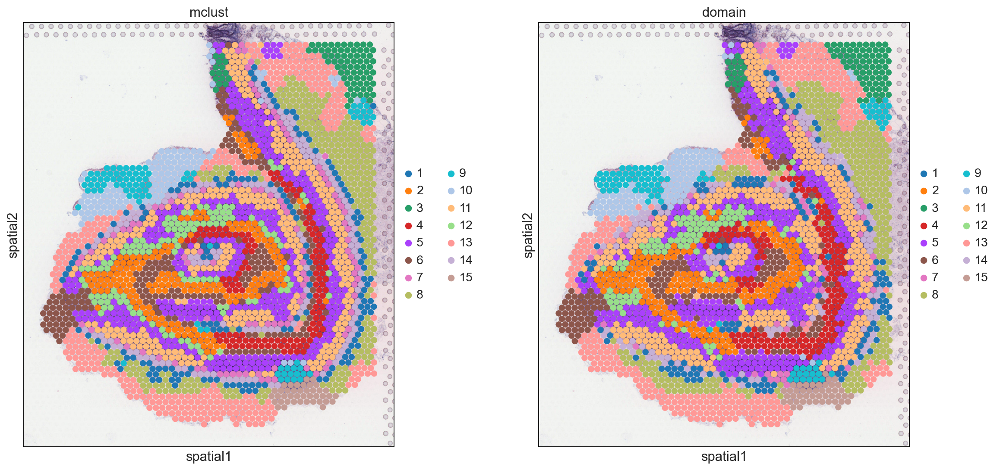

In [26]:
sc.pl.spatial(adata, color=['mclust', 'domain'], size=1.5)

In [145]:
transcript_data = adata[:, adata.var['highly_variable']].X.A
image_feature = adata.obsm['image_feature']
transcript_data.shape, image_feature.shape

((2649, 3000), (2649, 2048))

In [146]:
view_a_feature = PCA(n_components=100).fit_transform(transcript_data)
view_b_feature = PCA(n_components=100).fit_transform(image_feature)

view_a_label, _, _ = phenograph.cluster(view_a_feature)
view_b_label, _, _ = phenograph.cluster(view_b_feature)

Finding 30 nearest neighbors using minkowski metric and 'auto' algorithm
Neighbors computed in 0.10899972915649414 seconds
Jaccard graph constructed in 5.128878593444824 seconds
Wrote graph to binary file in 0.0219271183013916 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.738935
After 2 runs, maximum modularity is Q = 0.741726
Louvain completed 22 runs in 1.8445000648498535 seconds
Sorting communities by size, please wait ...
PhenoGraph completed in 10.694585084915161 seconds
Finding 30 nearest neighbors using minkowski metric and 'auto' algorithm
Neighbors computed in 0.11223435401916504 seconds
Jaccard graph constructed in 5.055443286895752 seconds
Wrote graph to binary file in 0.016999244689941406 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.771925
After 3 runs, maximum modularity is Q = 0.773129
After 4 runs, maximum modularity is Q = 0.774998
After 17 runs, maximum modularity is Q = 0.776206
L

In [147]:
import muse_sc as muse

muse_feature, reconstruct_x, reconstruct_y, latent_x, latent_y = muse.muse_fit_predict(
    transcript_data, 
    image_feature,
    view_a_label,
    view_b_label,
    latent_dim=100,
    n_epochs=250,
    lambda_regul=5,
    lambda_super=5)

++++++++++ MUSE for multi-modality single-cell analysis ++++++++++
MUSE initialization
epoch: 0, 	 total loss: 2584.12109,	 reconstruction loss: 1590.17371,	 sparse penalty: 198.78947
epoch: 50, 	 total loss: 1185.37927,	 reconstruction loss: 324.32452,	 sparse penalty: 172.21095
epoch: 100, 	 total loss: 1014.12292,	 reconstruction loss: 283.90875,	 sparse penalty: 146.04283
epoch: 150, 	 total loss: 865.85168,	 reconstruction loss: 254.30597,	 sparse penalty: 122.30914
epoch: 0, 	 total loss: 766.85248,	 reconstruction loss: 239.48074,	 sparse penalty: 101.18298,	 x triplet: 2.33518,	 y triplet: 1.95619
epoch: 50, 	 total loss: 657.96112,	 reconstruction loss: 222.85225,	 sparse penalty: 84.00032,	 x triplet: 1.58420,	 y triplet: 1.43725
epoch: 100, 	 total loss: 575.43689,	 reconstruction loss: 211.52060,	 sparse penalty: 69.85687,	 x triplet: 1.52723,	 y triplet: 1.39916
epoch: 150, 	 total loss: 508.91351,	 reconstruction loss: 204.72981,	 sparse penalty: 57.93742,	 x triplet: 1.5

Finding 30 nearest neighbors using minkowski metric and 'auto' algorithm
Neighbors computed in 0.11495471000671387 seconds
Jaccard graph constructed in 5.0887346267700195 seconds
Wrote graph to binary file in 0.01399993896484375 seconds
Running Louvain modularity optimization
After 1 runs, maximum modularity is Q = 0.892644
Louvain completed 21 runs in 1.5125269889831543 seconds
Sorting communities by size, please wait ...
PhenoGraph completed in 10.363621473312378 seconds


C:\ProgramData\anaconda3\envs\gpudeepl\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\ProgramData\anaconda3\envs\gpudeepl\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\ProgramData\anaconda3\envs\gpudeepl\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprec

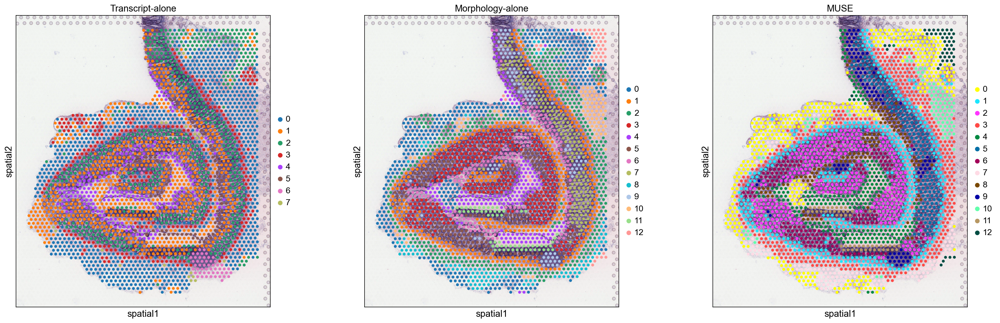

In [148]:
muse_label, _, _ = phenograph.cluster(muse_feature)

adata.obs['view_a_label'] = view_a_label
adata.obs['view_b_label'] = view_b_label
adata.obs['view_muse_label'] = muse_label
adata.obs['view_a_label'] = adata.obs['view_a_label'].astype('category')
adata.obs['view_b_label'] = adata.obs['view_b_label'].astype('category')
adata.obs['view_muse_label'] = adata.obs['view_muse_label'].astype('category')
sc.pl.spatial(adata, color=['view_a_label', 'view_b_label', 'view_muse_label'], title=['Transcript-alone', 'Morphology-alone', 'MUSE'])

C:\ProgramData\anaconda3\envs\gpudeepl\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\ProgramData\anaconda3\envs\gpudeepl\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprecated and will be changed to 'None' in a future version. Please set na_action to the desired value to avoid seeing this warning
  color_vector = pd.Categorical(values.map(color_map))
C:\ProgramData\anaconda3\envs\gpudeepl\lib\site-packages\scanpy\plotting\_tools\scatterplots.py:1251: FutureWarning: The default value of 'ignore' for the `na_action` parameter in pandas.Categorical.map is deprec

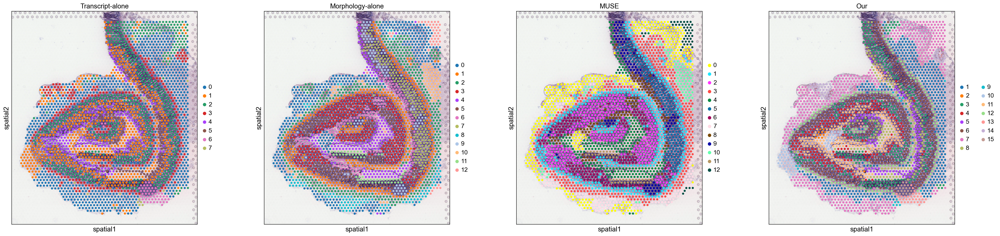

In [151]:
sc.pl.spatial(adata, color=['view_a_label', 'view_b_label', 'view_muse_label', 'mclust'], title=['Transcript-alone', 'Morphology-alone', 'MUSE', 'Our'])